In [1]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import sys
sys.path.insert(0, '../')

In [4]:
os.environ['CUDA_VISIBLE_DEVICES'] = '1,2'

# Training using the ResNet topology

In [5]:
from cpe775.networks.resnet import resnet34

In [6]:
net = resnet34(in_shape=(-1, 3, 224, 224), out_shape=(-1, 68, 2))

## Loading the dataset and splitting between train and valid

In [7]:
from cpe775.dataset import FaceLandmarksDataset, CroppedFaceLandmarksDataset
from torch.utils.data.sampler import SubsetRandomSampler
from torchvision.transforms import Compose
from cpe775.transforms import ToTensor, CropFace, ToGray, RandomHorizontalFlip, ToPILImage, RandomCrop, CenterCrop

In [8]:
batch_size = 128
random_seed = 42
valid_size = 0.2
shuffle = True

In [9]:
train_transforms = Compose([
                   ToPILImage(),
                   RandomCrop((224,224)),
                   RandomHorizontalFlip(),
                   ToTensor()
                 ])

transforms = Compose([
                   ToPILImage(),
                   CenterCrop((224,224)),
                   ToTensor()
                 ])

In [10]:
# load the dataset
train_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=train_transforms)
valid_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=transforms)

num_train = len(train_dataset)
indices = list(range(num_train))
split = int(np.floor(valid_size * num_train))

if shuffle == True:
    np.random.seed(random_seed)
    np.random.shuffle(indices)

train_idx, valid_idx = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_idx)
valid_sampler = SubsetRandomSampler(valid_idx)

train_loader = torch.utils.data.DataLoader(train_dataset, 
                batch_size=batch_size, sampler=train_sampler, num_workers=4)

valid_loader = torch.utils.data.DataLoader(valid_dataset, 
                batch_size=batch_size, sampler=valid_sampler, num_workers=4)

## Creating the model

In [11]:
net = torch.nn.DataParallel(net)
net = net.cuda()

In [12]:
np.sum([v.numel() for v in net.parameters()])

2239064

## Creating the loss function

In [13]:
import torch
from cpe775.criterion import NRMSELoss
from cpe775.model import Model
from cpe775 import callbacks

In [14]:
criterion = NRMSELoss()
criterion = criterion.cuda()

In [15]:
optimizer = torch.optim.SGD(net.parameters(), 0.05, momentum=0.9)
model = Model(net, criterion=criterion)
model.set_optimizer(optimizer)

## Training

In [16]:
from torch.optim.lr_scheduler import MultiStepLR
from cpe775 import metrics

In [17]:
callback_list = [
        callbacks.Progbar(print_freq=40),
        callbacks.ModelCheckpoint('../results/resnet/resnet-34-3c.pth.tar', 'val_loss', mode='min'),
        callbacks.LearningRateScheduler(MultiStepLR(optimizer, milestones=[750,900], gamma=0.1))
    ]

In [18]:
model.fit_loader(train_loader, 1000, val_loader=valid_loader,
                 callback=callbacks.Compose(callback_list), metrics={'rmse': NRMSELoss(weight=68)})

Epoch: [0][0/20]	Time 6.263 (6.263)	Data 0.273 (0.273)	Train Loss 4.109 (4.109)	Train Rmse 279.419 (279.419)	
Val: [0/5]	Time 0.435 (0.435)	Data 0.366 (0.366)	Val Loss 486.080 (486.080)	Val Rmse 33053.457 (33053.457)	
Epoch: [1][0/20]	Time 0.447 (0.447)	Data 0.356 (0.356)	Train Loss 0.714 (0.714)	Train Rmse 48.520 (48.520)	
Val: [0/5]	Time 0.422 (0.422)	Data 0.378 (0.378)	Val Loss 0.822 (0.822)	Val Rmse 55.919 (55.919)	
Epoch: [2][0/20]	Time 0.422 (0.422)	Data 0.332 (0.332)	Train Loss 0.388 (0.388)	Train Rmse 26.362 (26.362)	
Val: [0/5]	Time 0.373 (0.373)	Data 0.322 (0.322)	Val Loss 0.450 (0.450)	Val Rmse 30.569 (30.569)	
Epoch: [3][0/20]	Time 0.404 (0.404)	Data 0.343 (0.343)	Train Loss 0.478 (0.478)	Train Rmse 32.517 (32.517)	
Val: [0/5]	Time 0.394 (0.394)	Data 0.336 (0.336)	Val Loss 0.263 (0.263)	Val Rmse 17.917 (17.917)	
Epoch: [4][0/20]	Time 0.435 (0.435)	Data 0.341 (0.341)	Train Loss 0.361 (0.361)	Train Rmse 24.522 (24.522)	
Val: [0/5]	Time 0.374 (0.374)	Data 0.331 (0.331)	Val Los

Epoch: [40][0/20]	Time 0.410 (0.410)	Data 0.346 (0.346)	Train Loss 0.154 (0.154)	Train Rmse 10.458 (10.458)	
Val: [0/5]	Time 0.385 (0.385)	Data 0.343 (0.343)	Val Loss 0.171 (0.171)	Val Rmse 11.596 (11.596)	
Epoch: [41][0/20]	Time 0.391 (0.391)	Data 0.327 (0.327)	Train Loss 0.177 (0.177)	Train Rmse 12.027 (12.027)	
Val: [0/5]	Time 0.386 (0.386)	Data 0.345 (0.345)	Val Loss 0.170 (0.170)	Val Rmse 11.534 (11.534)	
Epoch: [42][0/20]	Time 0.468 (0.468)	Data 0.384 (0.384)	Train Loss 0.171 (0.171)	Train Rmse 11.652 (11.652)	
Val: [0/5]	Time 0.445 (0.445)	Data 0.403 (0.403)	Val Loss 0.143 (0.143)	Val Rmse 9.708 (9.708)	
Epoch: [43][0/20]	Time 0.467 (0.467)	Data 0.332 (0.332)	Train Loss 0.174 (0.174)	Train Rmse 11.798 (11.798)	
Val: [0/5]	Time 0.363 (0.363)	Data 0.317 (0.317)	Val Loss 0.142 (0.142)	Val Rmse 9.672 (9.672)	
Epoch: [44][0/20]	Time 0.395 (0.395)	Data 0.307 (0.307)	Train Loss 0.136 (0.136)	Train Rmse 9.236 (9.236)	
Val: [0/5]	Time 0.378 (0.378)	Data 0.326 (0.326)	Val Loss 0.125 (0.12

Val: [0/5]	Time 0.396 (0.396)	Data 0.327 (0.327)	Val Loss 0.108 (0.108)	Val Rmse 7.330 (7.330)	
Epoch: [81][0/20]	Time 0.461 (0.461)	Data 0.359 (0.359)	Train Loss 0.129 (0.129)	Train Rmse 8.752 (8.752)	
Val: [0/5]	Time 0.365 (0.365)	Data 0.323 (0.323)	Val Loss 0.105 (0.105)	Val Rmse 7.140 (7.140)	
Epoch: [82][0/20]	Time 0.440 (0.440)	Data 0.353 (0.353)	Train Loss 0.119 (0.119)	Train Rmse 8.125 (8.125)	
Val: [0/5]	Time 0.411 (0.411)	Data 0.360 (0.360)	Val Loss 0.109 (0.109)	Val Rmse 7.425 (7.425)	
Epoch: [83][0/20]	Time 0.438 (0.438)	Data 0.351 (0.351)	Train Loss 0.111 (0.111)	Train Rmse 7.550 (7.550)	
Val: [0/5]	Time 0.316 (0.316)	Data 0.278 (0.278)	Val Loss 0.110 (0.110)	Val Rmse 7.458 (7.458)	
Epoch: [84][0/20]	Time 0.475 (0.475)	Data 0.392 (0.392)	Train Loss 0.106 (0.106)	Train Rmse 7.197 (7.197)	
Val: [0/5]	Time 0.419 (0.419)	Data 0.377 (0.377)	Val Loss 0.095 (0.095)	Val Rmse 6.432 (6.432)	
Epoch: [85][0/20]	Time 0.388 (0.388)	Data 0.299 (0.299)	Train Loss 0.099 (0.099)	Train Rmse 

Epoch: [121][0/20]	Time 0.485 (0.485)	Data 0.380 (0.380)	Train Loss 0.085 (0.085)	Train Rmse 5.781 (5.781)	
Val: [0/5]	Time 0.349 (0.349)	Data 0.308 (0.308)	Val Loss 0.104 (0.104)	Val Rmse 7.044 (7.044)	
Epoch: [122][0/20]	Time 0.488 (0.488)	Data 0.390 (0.390)	Train Loss 0.097 (0.097)	Train Rmse 6.597 (6.597)	
Val: [0/5]	Time 0.409 (0.409)	Data 0.358 (0.358)	Val Loss 0.108 (0.108)	Val Rmse 7.318 (7.318)	
Epoch: [123][0/20]	Time 0.381 (0.381)	Data 0.320 (0.320)	Train Loss 0.096 (0.096)	Train Rmse 6.561 (6.561)	
Val: [0/5]	Time 0.364 (0.364)	Data 0.322 (0.322)	Val Loss 0.099 (0.099)	Val Rmse 6.722 (6.722)	
Epoch: [124][0/20]	Time 0.450 (0.450)	Data 0.366 (0.366)	Train Loss 0.091 (0.091)	Train Rmse 6.157 (6.157)	
Val: [0/5]	Time 0.423 (0.423)	Data 0.356 (0.356)	Val Loss 0.099 (0.099)	Val Rmse 6.741 (6.741)	
Epoch: [125][0/20]	Time 0.461 (0.461)	Data 0.384 (0.384)	Train Loss 0.084 (0.084)	Train Rmse 5.738 (5.738)	
Val: [0/5]	Time 0.448 (0.448)	Data 0.405 (0.405)	Val Loss 0.091 (0.091)	Val 

Val: [0/5]	Time 0.418 (0.418)	Data 0.367 (0.367)	Val Loss 0.098 (0.098)	Val Rmse 6.631 (6.631)	
Epoch: [162][0/20]	Time 0.365 (0.365)	Data 0.293 (0.293)	Train Loss 0.093 (0.093)	Train Rmse 6.323 (6.323)	
Val: [0/5]	Time 0.391 (0.391)	Data 0.344 (0.344)	Val Loss 0.081 (0.081)	Val Rmse 5.504 (5.504)	
Epoch: [163][0/20]	Time 0.602 (0.602)	Data 0.379 (0.379)	Train Loss 0.078 (0.078)	Train Rmse 5.278 (5.278)	
Val: [0/5]	Time 0.376 (0.376)	Data 0.329 (0.329)	Val Loss 0.089 (0.089)	Val Rmse 6.036 (6.036)	
Epoch: [164][0/20]	Time 0.486 (0.486)	Data 0.377 (0.377)	Train Loss 0.084 (0.084)	Train Rmse 5.695 (5.695)	
Val: [0/5]	Time 0.370 (0.370)	Data 0.327 (0.327)	Val Loss 0.083 (0.083)	Val Rmse 5.662 (5.662)	
Epoch: [165][0/20]	Time 0.431 (0.431)	Data 0.346 (0.346)	Train Loss 0.082 (0.082)	Train Rmse 5.562 (5.562)	
Val: [0/5]	Time 0.408 (0.408)	Data 0.364 (0.364)	Val Loss 0.094 (0.094)	Val Rmse 6.406 (6.406)	
Epoch: [166][0/20]	Time 0.491 (0.491)	Data 0.360 (0.360)	Train Loss 0.088 (0.088)	Train 

Epoch: [202][0/20]	Time 0.421 (0.421)	Data 0.340 (0.340)	Train Loss 0.079 (0.079)	Train Rmse 5.403 (5.403)	
Val: [0/5]	Time 0.365 (0.365)	Data 0.310 (0.310)	Val Loss 0.086 (0.086)	Val Rmse 5.878 (5.878)	
Epoch: [203][0/20]	Time 0.450 (0.450)	Data 0.366 (0.366)	Train Loss 0.088 (0.088)	Train Rmse 5.966 (5.966)	
Val: [0/5]	Time 0.376 (0.376)	Data 0.338 (0.338)	Val Loss 0.079 (0.079)	Val Rmse 5.363 (5.363)	
Epoch: [204][0/20]	Time 0.380 (0.380)	Data 0.302 (0.302)	Train Loss 0.076 (0.076)	Train Rmse 5.168 (5.168)	
Val: [0/5]	Time 0.397 (0.397)	Data 0.359 (0.359)	Val Loss 0.079 (0.079)	Val Rmse 5.355 (5.355)	
Epoch: [205][0/20]	Time 0.433 (0.433)	Data 0.353 (0.353)	Train Loss 0.073 (0.073)	Train Rmse 4.989 (4.989)	
Val: [0/5]	Time 0.390 (0.390)	Data 0.342 (0.342)	Val Loss 0.081 (0.081)	Val Rmse 5.488 (5.488)	
Epoch: [206][0/20]	Time 0.426 (0.426)	Data 0.353 (0.353)	Train Loss 0.084 (0.084)	Train Rmse 5.687 (5.687)	
Val: [0/5]	Time 0.379 (0.379)	Data 0.339 (0.339)	Val Loss 0.083 (0.083)	Val 

Val: [0/5]	Time 0.400 (0.400)	Data 0.331 (0.331)	Val Loss 0.079 (0.079)	Val Rmse 5.374 (5.374)	
Epoch: [243][0/20]	Time 0.450 (0.450)	Data 0.323 (0.323)	Train Loss 0.076 (0.076)	Train Rmse 5.184 (5.184)	
Val: [0/5]	Time 0.412 (0.412)	Data 0.364 (0.364)	Val Loss 0.077 (0.077)	Val Rmse 5.258 (5.258)	
Epoch: [244][0/20]	Time 0.453 (0.453)	Data 0.362 (0.362)	Train Loss 0.070 (0.070)	Train Rmse 4.764 (4.764)	
Val: [0/5]	Time 0.419 (0.419)	Data 0.378 (0.378)	Val Loss 0.073 (0.073)	Val Rmse 4.949 (4.949)	
Epoch: [245][0/20]	Time 0.455 (0.455)	Data 0.372 (0.372)	Train Loss 0.073 (0.073)	Train Rmse 4.950 (4.950)	
Val: [0/5]	Time 0.471 (0.471)	Data 0.415 (0.415)	Val Loss 0.080 (0.080)	Val Rmse 5.455 (5.455)	
Epoch: [246][0/20]	Time 0.457 (0.457)	Data 0.358 (0.358)	Train Loss 0.080 (0.080)	Train Rmse 5.446 (5.446)	
Val: [0/5]	Time 0.420 (0.420)	Data 0.369 (0.369)	Val Loss 0.083 (0.083)	Val Rmse 5.669 (5.669)	
Epoch: [247][0/20]	Time 0.475 (0.475)	Data 0.369 (0.369)	Train Loss 0.078 (0.078)	Train 

Epoch: [283][0/20]	Time 0.398 (0.398)	Data 0.332 (0.332)	Train Loss 0.065 (0.065)	Train Rmse 4.393 (4.393)	
Val: [0/5]	Time 0.384 (0.384)	Data 0.340 (0.340)	Val Loss 0.069 (0.069)	Val Rmse 4.700 (4.700)	
Epoch: [284][0/20]	Time 0.403 (0.403)	Data 0.326 (0.326)	Train Loss 0.067 (0.067)	Train Rmse 4.570 (4.570)	
Val: [0/5]	Time 0.387 (0.387)	Data 0.333 (0.333)	Val Loss 0.074 (0.074)	Val Rmse 5.033 (5.033)	
Epoch: [285][0/20]	Time 0.426 (0.426)	Data 0.327 (0.327)	Train Loss 0.068 (0.068)	Train Rmse 4.634 (4.634)	
Val: [0/5]	Time 0.404 (0.404)	Data 0.363 (0.363)	Val Loss 0.081 (0.081)	Val Rmse 5.510 (5.510)	
Epoch: [286][0/20]	Time 0.393 (0.393)	Data 0.333 (0.333)	Train Loss 0.075 (0.075)	Train Rmse 5.111 (5.111)	
Val: [0/5]	Time 0.414 (0.414)	Data 0.376 (0.376)	Val Loss 0.075 (0.075)	Val Rmse 5.074 (5.074)	
Epoch: [287][0/20]	Time 0.438 (0.438)	Data 0.351 (0.351)	Train Loss 0.071 (0.071)	Train Rmse 4.830 (4.830)	
Val: [0/5]	Time 0.354 (0.354)	Data 0.307 (0.307)	Val Loss 0.079 (0.079)	Val 

Val: [0/5]	Time 0.381 (0.381)	Data 0.344 (0.344)	Val Loss 0.076 (0.076)	Val Rmse 5.190 (5.190)	
Epoch: [324][0/20]	Time 0.378 (0.378)	Data 0.313 (0.313)	Train Loss 0.066 (0.066)	Train Rmse 4.510 (4.510)	
Val: [0/5]	Time 0.377 (0.377)	Data 0.335 (0.335)	Val Loss 0.077 (0.077)	Val Rmse 5.219 (5.219)	
Epoch: [325][0/20]	Time 0.415 (0.415)	Data 0.328 (0.328)	Train Loss 0.066 (0.066)	Train Rmse 4.465 (4.465)	
Val: [0/5]	Time 0.351 (0.351)	Data 0.308 (0.308)	Val Loss 0.068 (0.068)	Val Rmse 4.656 (4.656)	
Epoch: [326][0/20]	Time 0.433 (0.433)	Data 0.351 (0.351)	Train Loss 0.069 (0.069)	Train Rmse 4.674 (4.674)	
Val: [0/5]	Time 0.382 (0.382)	Data 0.345 (0.345)	Val Loss 0.081 (0.081)	Val Rmse 5.541 (5.541)	
Epoch: [327][0/20]	Time 0.397 (0.397)	Data 0.333 (0.333)	Train Loss 0.069 (0.069)	Train Rmse 4.669 (4.669)	
Val: [0/5]	Time 0.364 (0.364)	Data 0.320 (0.320)	Val Loss 0.073 (0.073)	Val Rmse 4.995 (4.995)	
Epoch: [328][0/20]	Time 0.418 (0.418)	Data 0.340 (0.340)	Train Loss 0.064 (0.064)	Train 

Epoch: [364][0/20]	Time 0.387 (0.387)	Data 0.309 (0.309)	Train Loss 0.065 (0.065)	Train Rmse 4.396 (4.396)	
Val: [0/5]	Time 0.330 (0.330)	Data 0.290 (0.290)	Val Loss 0.072 (0.072)	Val Rmse 4.869 (4.869)	
Epoch: [365][0/20]	Time 0.403 (0.403)	Data 0.345 (0.345)	Train Loss 0.066 (0.066)	Train Rmse 4.509 (4.509)	
Val: [0/5]	Time 0.358 (0.358)	Data 0.321 (0.321)	Val Loss 0.075 (0.075)	Val Rmse 5.070 (5.070)	
Epoch: [366][0/20]	Time 0.402 (0.402)	Data 0.325 (0.325)	Train Loss 0.066 (0.066)	Train Rmse 4.500 (4.500)	
Val: [0/5]	Time 0.368 (0.368)	Data 0.319 (0.319)	Val Loss 0.070 (0.070)	Val Rmse 4.776 (4.776)	
Epoch: [367][0/20]	Time 0.390 (0.390)	Data 0.313 (0.313)	Train Loss 0.066 (0.066)	Train Rmse 4.506 (4.506)	
Val: [0/5]	Time 0.373 (0.373)	Data 0.327 (0.327)	Val Loss 0.071 (0.071)	Val Rmse 4.838 (4.838)	
Epoch: [368][0/20]	Time 0.409 (0.409)	Data 0.331 (0.331)	Train Loss 0.064 (0.064)	Train Rmse 4.360 (4.360)	
Val: [0/5]	Time 0.345 (0.345)	Data 0.306 (0.306)	Val Loss 0.073 (0.073)	Val 

Val: [0/5]	Time 0.371 (0.371)	Data 0.326 (0.326)	Val Loss 0.071 (0.071)	Val Rmse 4.833 (4.833)	
Epoch: [405][0/20]	Time 0.358 (0.358)	Data 0.289 (0.289)	Train Loss 0.063 (0.063)	Train Rmse 4.299 (4.299)	
Val: [0/5]	Time 0.328 (0.328)	Data 0.286 (0.286)	Val Loss 0.078 (0.078)	Val Rmse 5.270 (5.270)	
Epoch: [406][0/20]	Time 0.404 (0.404)	Data 0.330 (0.330)	Train Loss 0.063 (0.063)	Train Rmse 4.274 (4.274)	
Val: [0/5]	Time 0.366 (0.366)	Data 0.326 (0.326)	Val Loss 0.067 (0.067)	Val Rmse 4.529 (4.529)	
Epoch: [407][0/20]	Time 0.368 (0.368)	Data 0.302 (0.302)	Train Loss 0.064 (0.064)	Train Rmse 4.348 (4.348)	
Val: [0/5]	Time 0.360 (0.360)	Data 0.320 (0.320)	Val Loss 0.070 (0.070)	Val Rmse 4.768 (4.768)	
Epoch: [408][0/20]	Time 0.384 (0.384)	Data 0.306 (0.306)	Train Loss 0.063 (0.063)	Train Rmse 4.288 (4.288)	
Val: [0/5]	Time 0.325 (0.325)	Data 0.287 (0.287)	Val Loss 0.072 (0.072)	Val Rmse 4.865 (4.865)	
Epoch: [409][0/20]	Time 0.358 (0.358)	Data 0.293 (0.293)	Train Loss 0.064 (0.064)	Train 

Epoch: [445][0/20]	Time 0.481 (0.481)	Data 0.328 (0.328)	Train Loss 0.061 (0.061)	Train Rmse 4.119 (4.119)	
Val: [0/5]	Time 0.335 (0.335)	Data 0.291 (0.291)	Val Loss 0.070 (0.070)	Val Rmse 4.741 (4.741)	
Epoch: [446][0/20]	Time 0.385 (0.385)	Data 0.327 (0.327)	Train Loss 0.062 (0.062)	Train Rmse 4.184 (4.184)	
Val: [0/5]	Time 0.349 (0.349)	Data 0.301 (0.301)	Val Loss 0.074 (0.074)	Val Rmse 5.002 (5.002)	
Epoch: [447][0/20]	Time 0.416 (0.416)	Data 0.335 (0.335)	Train Loss 0.061 (0.061)	Train Rmse 4.122 (4.122)	
Val: [0/5]	Time 0.338 (0.338)	Data 0.300 (0.300)	Val Loss 0.070 (0.070)	Val Rmse 4.778 (4.778)	
Epoch: [448][0/20]	Time 0.418 (0.418)	Data 0.341 (0.341)	Train Loss 0.061 (0.061)	Train Rmse 4.157 (4.157)	
Val: [0/5]	Time 0.341 (0.341)	Data 0.296 (0.296)	Val Loss 0.069 (0.069)	Val Rmse 4.717 (4.717)	
Epoch: [449][0/20]	Time 0.380 (0.380)	Data 0.311 (0.311)	Train Loss 0.062 (0.062)	Train Rmse 4.231 (4.231)	
Val: [0/5]	Time 0.321 (0.321)	Data 0.281 (0.281)	Val Loss 0.073 (0.073)	Val 

Val: [0/5]	Time 0.328 (0.328)	Data 0.291 (0.291)	Val Loss 0.069 (0.069)	Val Rmse 4.664 (4.664)	
Epoch: [486][0/20]	Time 0.351 (0.351)	Data 0.285 (0.285)	Train Loss 0.063 (0.063)	Train Rmse 4.282 (4.282)	
Val: [0/5]	Time 0.314 (0.314)	Data 0.277 (0.277)	Val Loss 0.068 (0.068)	Val Rmse 4.607 (4.607)	
Epoch: [487][0/20]	Time 0.361 (0.361)	Data 0.300 (0.300)	Train Loss 0.059 (0.059)	Train Rmse 4.029 (4.029)	
Val: [0/5]	Time 0.351 (0.351)	Data 0.310 (0.310)	Val Loss 0.070 (0.070)	Val Rmse 4.734 (4.734)	
Epoch: [488][0/20]	Time 0.378 (0.378)	Data 0.304 (0.304)	Train Loss 0.058 (0.058)	Train Rmse 3.913 (3.913)	
Val: [0/5]	Time 0.395 (0.395)	Data 0.350 (0.350)	Val Loss 0.073 (0.073)	Val Rmse 4.974 (4.974)	
Epoch: [489][0/20]	Time 0.381 (0.381)	Data 0.293 (0.293)	Train Loss 0.063 (0.063)	Train Rmse 4.268 (4.268)	
Val: [0/5]	Time 0.325 (0.325)	Data 0.288 (0.288)	Val Loss 0.068 (0.068)	Val Rmse 4.645 (4.645)	
Epoch: [490][0/20]	Time 0.342 (0.342)	Data 0.281 (0.281)	Train Loss 0.059 (0.059)	Train 

Epoch: [526][0/20]	Time 0.364 (0.364)	Data 0.295 (0.295)	Train Loss 0.058 (0.058)	Train Rmse 3.930 (3.930)	
Val: [0/5]	Time 0.337 (0.337)	Data 0.294 (0.294)	Val Loss 0.069 (0.069)	Val Rmse 4.708 (4.708)	
Epoch: [527][0/20]	Time 0.345 (0.345)	Data 0.284 (0.284)	Train Loss 0.060 (0.060)	Train Rmse 4.078 (4.078)	
Val: [0/5]	Time 0.326 (0.326)	Data 0.286 (0.286)	Val Loss 0.070 (0.070)	Val Rmse 4.773 (4.773)	
Epoch: [528][0/20]	Time 0.385 (0.385)	Data 0.317 (0.317)	Train Loss 0.057 (0.057)	Train Rmse 3.873 (3.873)	
Val: [0/5]	Time 0.335 (0.335)	Data 0.292 (0.292)	Val Loss 0.071 (0.071)	Val Rmse 4.796 (4.796)	
Epoch: [529][0/20]	Time 0.388 (0.388)	Data 0.317 (0.317)	Train Loss 0.057 (0.057)	Train Rmse 3.870 (3.870)	
Val: [0/5]	Time 0.336 (0.336)	Data 0.296 (0.296)	Val Loss 0.068 (0.068)	Val Rmse 4.658 (4.658)	
Epoch: [530][0/20]	Time 0.373 (0.373)	Data 0.316 (0.316)	Train Loss 0.057 (0.057)	Train Rmse 3.846 (3.846)	
Val: [0/5]	Time 0.326 (0.326)	Data 0.288 (0.288)	Val Loss 0.065 (0.065)	Val 

Val: [0/5]	Time 0.328 (0.328)	Data 0.291 (0.291)	Val Loss 0.071 (0.071)	Val Rmse 4.836 (4.836)	
Epoch: [567][0/20]	Time 0.364 (0.364)	Data 0.301 (0.301)	Train Loss 0.058 (0.058)	Train Rmse 3.954 (3.954)	
Val: [0/5]	Time 0.321 (0.321)	Data 0.282 (0.282)	Val Loss 0.067 (0.067)	Val Rmse 4.550 (4.550)	
Epoch: [568][0/20]	Time 0.354 (0.354)	Data 0.292 (0.292)	Train Loss 0.055 (0.055)	Train Rmse 3.712 (3.712)	
Val: [0/5]	Time 0.321 (0.321)	Data 0.278 (0.278)	Val Loss 0.072 (0.072)	Val Rmse 4.909 (4.909)	
Epoch: [569][0/20]	Time 0.341 (0.341)	Data 0.286 (0.286)	Train Loss 0.060 (0.060)	Train Rmse 4.053 (4.053)	
Val: [0/5]	Time 0.314 (0.314)	Data 0.276 (0.276)	Val Loss 0.072 (0.072)	Val Rmse 4.889 (4.889)	
Epoch: [570][0/20]	Time 0.394 (0.394)	Data 0.335 (0.335)	Train Loss 0.056 (0.056)	Train Rmse 3.823 (3.823)	
Val: [0/5]	Time 0.332 (0.332)	Data 0.291 (0.291)	Val Loss 0.067 (0.067)	Val Rmse 4.533 (4.533)	
Epoch: [571][0/20]	Time 0.356 (0.356)	Data 0.288 (0.288)	Train Loss 0.053 (0.053)	Train 

Epoch: [607][0/20]	Time 0.420 (0.420)	Data 0.352 (0.352)	Train Loss 0.057 (0.057)	Train Rmse 3.851 (3.851)	
Val: [0/5]	Time 0.342 (0.342)	Data 0.299 (0.299)	Val Loss 0.069 (0.069)	Val Rmse 4.662 (4.662)	
Epoch: [608][0/20]	Time 0.418 (0.418)	Data 0.329 (0.329)	Train Loss 0.059 (0.059)	Train Rmse 4.031 (4.031)	
Val: [0/5]	Time 0.339 (0.339)	Data 0.301 (0.301)	Val Loss 0.067 (0.067)	Val Rmse 4.581 (4.581)	
Epoch: [609][0/20]	Time 0.386 (0.386)	Data 0.320 (0.320)	Train Loss 0.058 (0.058)	Train Rmse 3.962 (3.962)	
Val: [0/5]	Time 0.332 (0.332)	Data 0.293 (0.293)	Val Loss 0.069 (0.069)	Val Rmse 4.677 (4.677)	
Epoch: [610][0/20]	Time 0.403 (0.403)	Data 0.315 (0.315)	Train Loss 0.057 (0.057)	Train Rmse 3.901 (3.901)	
Val: [0/5]	Time 0.376 (0.376)	Data 0.331 (0.331)	Val Loss 0.070 (0.070)	Val Rmse 4.791 (4.791)	
Epoch: [611][0/20]	Time 0.439 (0.439)	Data 0.358 (0.358)	Train Loss 0.059 (0.059)	Train Rmse 4.006 (4.006)	
Val: [0/5]	Time 0.364 (0.364)	Data 0.309 (0.309)	Val Loss 0.072 (0.072)	Val 

Val: [0/5]	Time 0.365 (0.365)	Data 0.305 (0.305)	Val Loss 0.068 (0.068)	Val Rmse 4.626 (4.626)	
Epoch: [648][0/20]	Time 0.399 (0.399)	Data 0.337 (0.337)	Train Loss 0.056 (0.056)	Train Rmse 3.786 (3.786)	
Val: [0/5]	Time 0.340 (0.340)	Data 0.302 (0.302)	Val Loss 0.066 (0.066)	Val Rmse 4.472 (4.472)	
Epoch: [649][0/20]	Time 0.391 (0.391)	Data 0.312 (0.312)	Train Loss 0.057 (0.057)	Train Rmse 3.888 (3.888)	
Val: [0/5]	Time 0.345 (0.345)	Data 0.301 (0.301)	Val Loss 0.069 (0.069)	Val Rmse 4.688 (4.688)	
Epoch: [650][0/20]	Time 0.388 (0.388)	Data 0.322 (0.322)	Train Loss 0.055 (0.055)	Train Rmse 3.718 (3.718)	
Val: [0/5]	Time 0.373 (0.373)	Data 0.336 (0.336)	Val Loss 0.074 (0.074)	Val Rmse 5.023 (5.023)	
Epoch: [651][0/20]	Time 0.404 (0.404)	Data 0.331 (0.331)	Train Loss 0.057 (0.057)	Train Rmse 3.897 (3.897)	
Val: [0/5]	Time 0.378 (0.378)	Data 0.337 (0.337)	Val Loss 0.072 (0.072)	Val Rmse 4.927 (4.927)	
Epoch: [652][0/20]	Time 0.404 (0.404)	Data 0.338 (0.338)	Train Loss 0.054 (0.054)	Train 

Epoch: [688][0/20]	Time 0.384 (0.384)	Data 0.309 (0.309)	Train Loss 0.053 (0.053)	Train Rmse 3.619 (3.619)	
Val: [0/5]	Time 0.350 (0.350)	Data 0.304 (0.304)	Val Loss 0.066 (0.066)	Val Rmse 4.522 (4.522)	
Epoch: [689][0/20]	Time 0.454 (0.454)	Data 0.380 (0.380)	Train Loss 0.062 (0.062)	Train Rmse 4.212 (4.212)	
Val: [0/5]	Time 0.399 (0.399)	Data 0.345 (0.345)	Val Loss 0.071 (0.071)	Val Rmse 4.808 (4.808)	
Epoch: [690][0/20]	Time 0.426 (0.426)	Data 0.346 (0.346)	Train Loss 0.056 (0.056)	Train Rmse 3.797 (3.797)	
Val: [0/5]	Time 0.375 (0.375)	Data 0.338 (0.338)	Val Loss 0.067 (0.067)	Val Rmse 4.566 (4.566)	
Epoch: [691][0/20]	Time 0.427 (0.427)	Data 0.335 (0.335)	Train Loss 0.055 (0.055)	Train Rmse 3.769 (3.769)	
Val: [0/5]	Time 0.368 (0.368)	Data 0.320 (0.320)	Val Loss 0.069 (0.069)	Val Rmse 4.684 (4.684)	
Epoch: [692][0/20]	Time 0.433 (0.433)	Data 0.342 (0.342)	Train Loss 0.055 (0.055)	Train Rmse 3.757 (3.757)	
Val: [0/5]	Time 0.386 (0.386)	Data 0.343 (0.343)	Val Loss 0.066 (0.066)	Val 

Val: [0/5]	Time 0.352 (0.352)	Data 0.313 (0.313)	Val Loss 0.069 (0.069)	Val Rmse 4.696 (4.696)	
Epoch: [729][0/20]	Time 0.367 (0.367)	Data 0.298 (0.298)	Train Loss 0.055 (0.055)	Train Rmse 3.767 (3.767)	
Val: [0/5]	Time 0.355 (0.355)	Data 0.311 (0.311)	Val Loss 0.066 (0.066)	Val Rmse 4.517 (4.517)	
Epoch: [730][0/20]	Time 0.406 (0.406)	Data 0.339 (0.339)	Train Loss 0.053 (0.053)	Train Rmse 3.596 (3.596)	
Val: [0/5]	Time 0.371 (0.371)	Data 0.312 (0.312)	Val Loss 0.066 (0.066)	Val Rmse 4.483 (4.483)	
Epoch: [731][0/20]	Time 0.409 (0.409)	Data 0.326 (0.326)	Train Loss 0.056 (0.056)	Train Rmse 3.817 (3.817)	
Val: [0/5]	Time 0.396 (0.396)	Data 0.355 (0.355)	Val Loss 0.068 (0.068)	Val Rmse 4.604 (4.604)	
Epoch: [732][0/20]	Time 0.384 (0.384)	Data 0.319 (0.319)	Train Loss 0.054 (0.054)	Train Rmse 3.681 (3.681)	
Val: [0/5]	Time 0.370 (0.370)	Data 0.320 (0.320)	Val Loss 0.066 (0.066)	Val Rmse 4.471 (4.471)	
Epoch: [733][0/20]	Time 0.417 (0.417)	Data 0.345 (0.345)	Train Loss 0.054 (0.054)	Train 

Epoch: [769][0/20]	Time 0.389 (0.389)	Data 0.334 (0.334)	Train Loss 0.051 (0.051)	Train Rmse 3.501 (3.501)	
Val: [0/5]	Time 0.375 (0.375)	Data 0.336 (0.336)	Val Loss 0.068 (0.068)	Val Rmse 4.618 (4.618)	
Epoch: [770][0/20]	Time 0.378 (0.378)	Data 0.299 (0.299)	Train Loss 0.050 (0.050)	Train Rmse 3.407 (3.407)	
Val: [0/5]	Time 0.380 (0.380)	Data 0.332 (0.332)	Val Loss 0.068 (0.068)	Val Rmse 4.651 (4.651)	
Epoch: [771][0/20]	Time 0.388 (0.388)	Data 0.296 (0.296)	Train Loss 0.051 (0.051)	Train Rmse 3.502 (3.502)	
Val: [0/5]	Time 0.354 (0.354)	Data 0.314 (0.314)	Val Loss 0.067 (0.067)	Val Rmse 4.575 (4.575)	
Epoch: [772][0/20]	Time 0.384 (0.384)	Data 0.319 (0.319)	Train Loss 0.051 (0.051)	Train Rmse 3.496 (3.496)	
Val: [0/5]	Time 0.361 (0.361)	Data 0.324 (0.324)	Val Loss 0.064 (0.064)	Val Rmse 4.351 (4.351)	
Epoch: [773][0/20]	Time 0.365 (0.365)	Data 0.291 (0.291)	Train Loss 0.050 (0.050)	Train Rmse 3.369 (3.369)	
Val: [0/5]	Time 0.324 (0.324)	Data 0.284 (0.284)	Val Loss 0.067 (0.067)	Val 

Val: [0/5]	Time 0.351 (0.351)	Data 0.308 (0.308)	Val Loss 0.065 (0.065)	Val Rmse 4.417 (4.417)	
Epoch: [810][0/20]	Time 0.383 (0.383)	Data 0.310 (0.310)	Train Loss 0.053 (0.053)	Train Rmse 3.576 (3.576)	
Val: [0/5]	Time 0.386 (0.386)	Data 0.340 (0.340)	Val Loss 0.065 (0.065)	Val Rmse 4.449 (4.449)	
Epoch: [811][0/20]	Time 0.399 (0.399)	Data 0.323 (0.323)	Train Loss 0.052 (0.052)	Train Rmse 3.522 (3.522)	
Val: [0/5]	Time 0.345 (0.345)	Data 0.304 (0.304)	Val Loss 0.063 (0.063)	Val Rmse 4.261 (4.261)	
Epoch: [812][0/20]	Time 0.363 (0.363)	Data 0.307 (0.307)	Train Loss 0.054 (0.054)	Train Rmse 3.652 (3.652)	
Val: [0/5]	Time 0.367 (0.367)	Data 0.327 (0.327)	Val Loss 0.065 (0.065)	Val Rmse 4.418 (4.418)	
Epoch: [813][0/20]	Time 0.385 (0.385)	Data 0.322 (0.322)	Train Loss 0.050 (0.050)	Train Rmse 3.407 (3.407)	
Val: [0/5]	Time 0.360 (0.360)	Data 0.323 (0.323)	Val Loss 0.066 (0.066)	Val Rmse 4.478 (4.478)	
Epoch: [814][0/20]	Time 0.358 (0.358)	Data 0.294 (0.294)	Train Loss 0.054 (0.054)	Train 

Epoch: [850][0/20]	Time 0.376 (0.376)	Data 0.308 (0.308)	Train Loss 0.050 (0.050)	Train Rmse 3.431 (3.431)	
Val: [0/5]	Time 0.381 (0.381)	Data 0.333 (0.333)	Val Loss 0.061 (0.061)	Val Rmse 4.128 (4.128)	
Epoch: [851][0/20]	Time 0.405 (0.405)	Data 0.335 (0.335)	Train Loss 0.053 (0.053)	Train Rmse 3.608 (3.608)	
Val: [0/5]	Time 0.331 (0.331)	Data 0.283 (0.283)	Val Loss 0.067 (0.067)	Val Rmse 4.577 (4.577)	
Epoch: [852][0/20]	Time 0.371 (0.371)	Data 0.302 (0.302)	Train Loss 0.051 (0.051)	Train Rmse 3.494 (3.494)	
Val: [0/5]	Time 0.342 (0.342)	Data 0.302 (0.302)	Val Loss 0.066 (0.066)	Val Rmse 4.475 (4.475)	
Epoch: [853][0/20]	Time 0.391 (0.391)	Data 0.320 (0.320)	Train Loss 0.050 (0.050)	Train Rmse 3.403 (3.403)	
Val: [0/5]	Time 0.364 (0.364)	Data 0.320 (0.320)	Val Loss 0.067 (0.067)	Val Rmse 4.557 (4.557)	
Epoch: [854][0/20]	Time 0.361 (0.361)	Data 0.303 (0.303)	Train Loss 0.050 (0.050)	Train Rmse 3.383 (3.383)	
Val: [0/5]	Time 0.369 (0.369)	Data 0.329 (0.329)	Val Loss 0.067 (0.067)	Val 

Val: [0/5]	Time 0.361 (0.361)	Data 0.313 (0.313)	Val Loss 0.062 (0.062)	Val Rmse 4.236 (4.236)	
Epoch: [891][0/20]	Time 0.408 (0.408)	Data 0.324 (0.324)	Train Loss 0.051 (0.051)	Train Rmse 3.439 (3.439)	
Val: [0/5]	Time 0.349 (0.349)	Data 0.307 (0.307)	Val Loss 0.065 (0.065)	Val Rmse 4.453 (4.453)	
Epoch: [892][0/20]	Time 0.374 (0.374)	Data 0.315 (0.315)	Train Loss 0.052 (0.052)	Train Rmse 3.559 (3.559)	
Val: [0/5]	Time 0.359 (0.359)	Data 0.316 (0.316)	Val Loss 0.066 (0.066)	Val Rmse 4.494 (4.494)	
Epoch: [893][0/20]	Time 0.394 (0.394)	Data 0.320 (0.320)	Train Loss 0.053 (0.053)	Train Rmse 3.609 (3.609)	
Val: [0/5]	Time 0.400 (0.400)	Data 0.356 (0.356)	Val Loss 0.069 (0.069)	Val Rmse 4.678 (4.678)	
Epoch: [894][0/20]	Time 0.438 (0.438)	Data 0.355 (0.355)	Train Loss 0.052 (0.052)	Train Rmse 3.555 (3.555)	
Val: [0/5]	Time 0.346 (0.346)	Data 0.308 (0.308)	Val Loss 0.066 (0.066)	Val Rmse 4.501 (4.501)	
Epoch: [895][0/20]	Time 0.417 (0.417)	Data 0.328 (0.328)	Train Loss 0.052 (0.052)	Train 

Epoch: [931][0/20]	Time 0.377 (0.377)	Data 0.296 (0.296)	Train Loss 0.050 (0.050)	Train Rmse 3.429 (3.429)	
Val: [0/5]	Time 0.391 (0.391)	Data 0.352 (0.352)	Val Loss 0.068 (0.068)	Val Rmse 4.603 (4.603)	
Epoch: [932][0/20]	Time 0.362 (0.362)	Data 0.289 (0.289)	Train Loss 0.051 (0.051)	Train Rmse 3.474 (3.474)	
Val: [0/5]	Time 0.344 (0.344)	Data 0.297 (0.297)	Val Loss 0.067 (0.067)	Val Rmse 4.534 (4.534)	
Epoch: [933][0/20]	Time 0.413 (0.413)	Data 0.344 (0.344)	Train Loss 0.050 (0.050)	Train Rmse 3.383 (3.383)	
Val: [0/5]	Time 0.337 (0.337)	Data 0.295 (0.295)	Val Loss 0.065 (0.065)	Val Rmse 4.419 (4.419)	
Epoch: [934][0/20]	Time 0.365 (0.365)	Data 0.294 (0.294)	Train Loss 0.050 (0.050)	Train Rmse 3.422 (3.422)	
Val: [0/5]	Time 0.350 (0.350)	Data 0.311 (0.311)	Val Loss 0.066 (0.066)	Val Rmse 4.486 (4.486)	
Epoch: [935][0/20]	Time 0.399 (0.399)	Data 0.332 (0.332)	Train Loss 0.053 (0.053)	Train Rmse 3.603 (3.603)	
Val: [0/5]	Time 0.380 (0.380)	Data 0.336 (0.336)	Val Loss 0.067 (0.067)	Val 

Val: [0/5]	Time 0.342 (0.342)	Data 0.296 (0.296)	Val Loss 0.063 (0.063)	Val Rmse 4.290 (4.290)	
Epoch: [972][0/20]	Time 0.398 (0.398)	Data 0.322 (0.322)	Train Loss 0.051 (0.051)	Train Rmse 3.455 (3.455)	
Val: [0/5]	Time 0.367 (0.367)	Data 0.330 (0.330)	Val Loss 0.064 (0.064)	Val Rmse 4.346 (4.346)	
Epoch: [973][0/20]	Time 0.356 (0.356)	Data 0.293 (0.293)	Train Loss 0.050 (0.050)	Train Rmse 3.418 (3.418)	
Val: [0/5]	Time 0.359 (0.359)	Data 0.313 (0.313)	Val Loss 0.066 (0.066)	Val Rmse 4.477 (4.477)	
Epoch: [974][0/20]	Time 0.352 (0.352)	Data 0.297 (0.297)	Train Loss 0.050 (0.050)	Train Rmse 3.421 (3.421)	
Val: [0/5]	Time 0.358 (0.358)	Data 0.321 (0.321)	Val Loss 0.064 (0.064)	Val Rmse 4.325 (4.325)	
Epoch: [975][0/20]	Time 0.376 (0.376)	Data 0.305 (0.305)	Train Loss 0.051 (0.051)	Train Rmse 3.499 (3.499)	
Val: [0/5]	Time 0.332 (0.332)	Data 0.291 (0.291)	Val Loss 0.064 (0.064)	Val Rmse 4.320 (4.320)	
Epoch: [976][0/20]	Time 0.401 (0.401)	Data 0.323 (0.323)	Train Loss 0.050 (0.050)	Train 

[autoreload of cpe775.transforms failed: Traceback (most recent call last):
  File "/home/igor.quintanilha/miniconda3/envs/dsc/lib/python3.5/site-packages/IPython/extensions/autoreload.py", line 246, in check
    superreload(m, reload, self.old_objects)
  File "/home/igor.quintanilha/miniconda3/envs/dsc/lib/python3.5/site-packages/IPython/extensions/autoreload.py", line 385, in superreload
    update_generic(old_obj, new_obj)
  File "/home/igor.quintanilha/miniconda3/envs/dsc/lib/python3.5/site-packages/IPython/extensions/autoreload.py", line 324, in update_generic
    update(a, b)
  File "/home/igor.quintanilha/miniconda3/envs/dsc/lib/python3.5/site-packages/IPython/extensions/autoreload.py", line 279, in update_class
    if old_obj == new_obj:
ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()
]


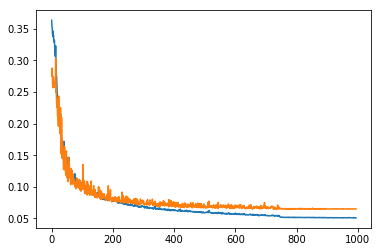

In [19]:
plt.plot(callback_list[1].history['train_loss'][5:])
plt.plot(callback_list[1].history['val_loss'][5:])

In [20]:
checkpoint = torch.load('../results/resnet/resnet-34-3c.pth-best.tar')

## Loading the best model

In [21]:
from cpe775.utils.img_utils import show_landmarks_batch

In [22]:
net = resnet34(in_shape=(-1, 3, 224, 224), out_shape=(-1, 68, 2))

In [23]:
best_model = Model(net)
best_net = model.net
best_net.load_state_dict(checkpoint['state_dict'])

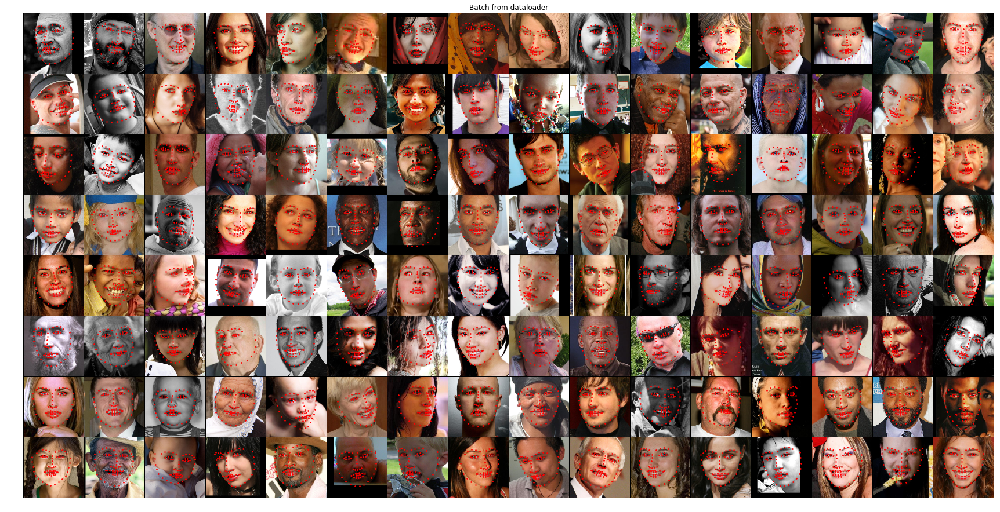

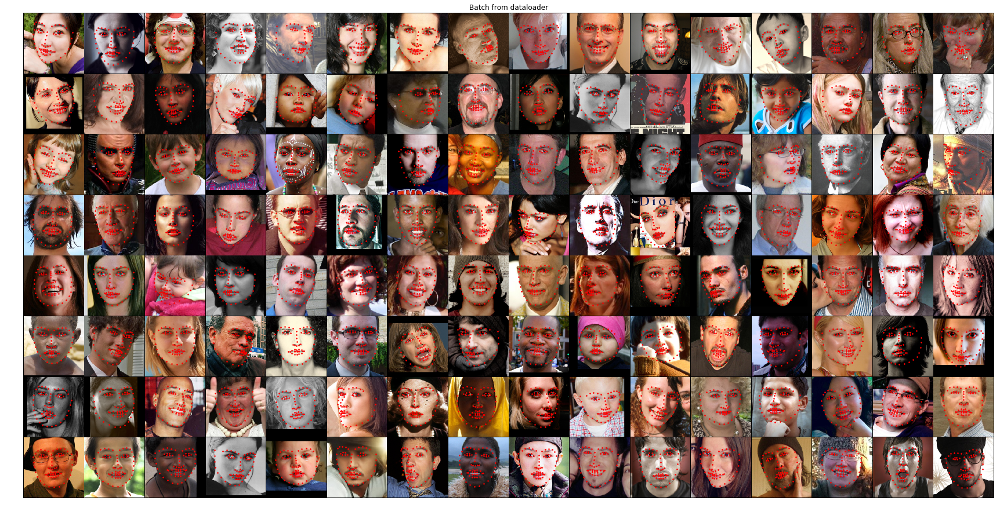

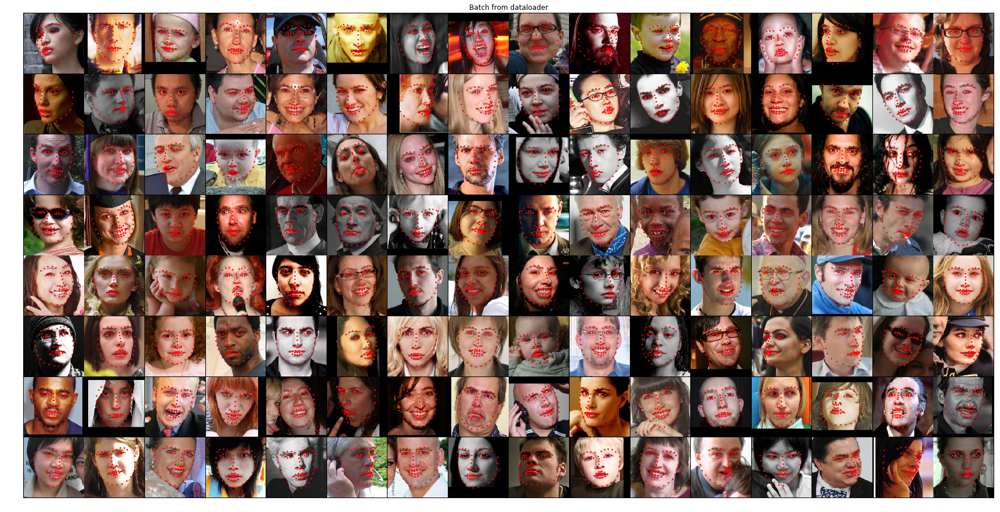

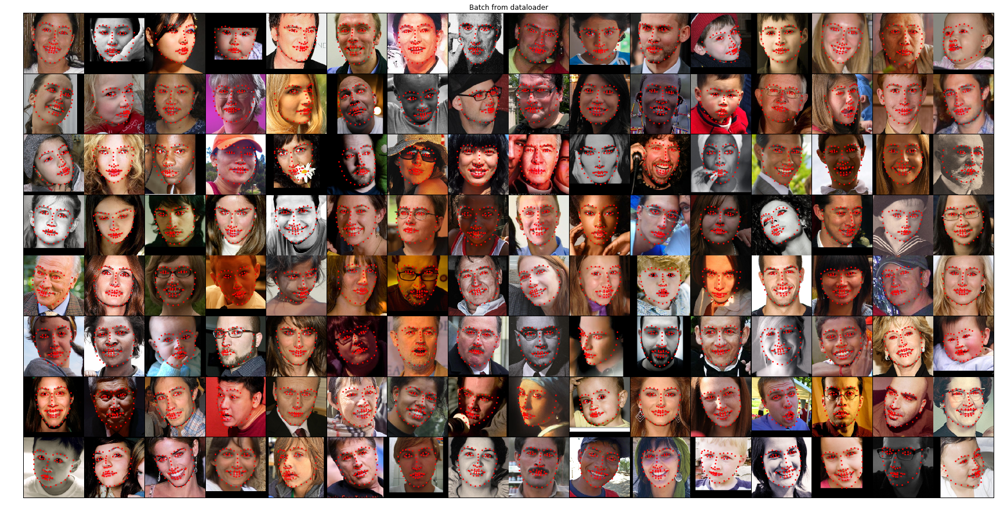

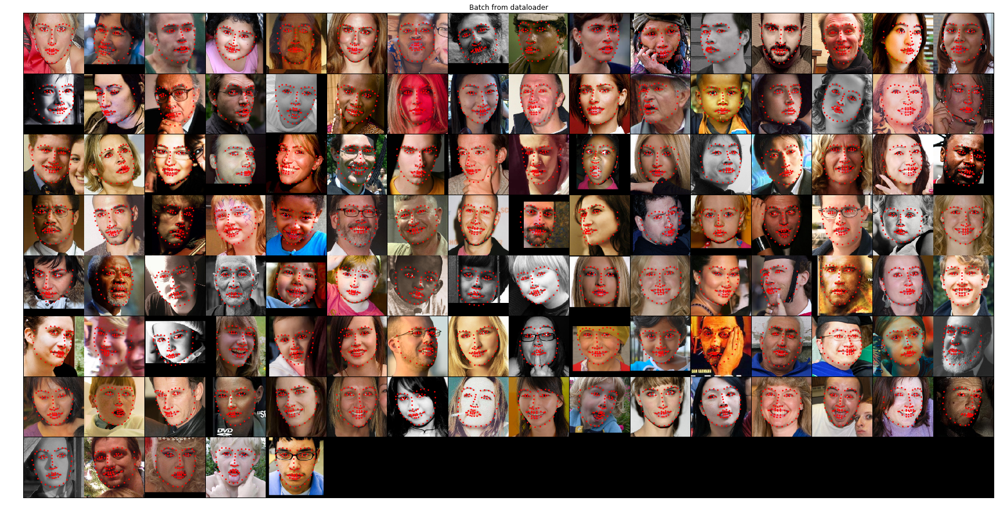

In [24]:
for i_batch, sample_batched in enumerate(valid_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data

    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)

    plt.axis('off')
    plt.ioff()
    plt.show()

### Common test

In [25]:
transforms = Compose([
                   CropFace(),
                   CenterCrop((224,224)),
                   ToTensor()
                 ])

In [26]:
# load the dataset
dataset = FaceLandmarksDataset(csv_file='../data/common_test.csv',
                               root_dir='../data/',
                               transform=transforms)

common_loader = torch.utils.data.DataLoader(dataset, 
                batch_size=batch_size, num_workers=4)

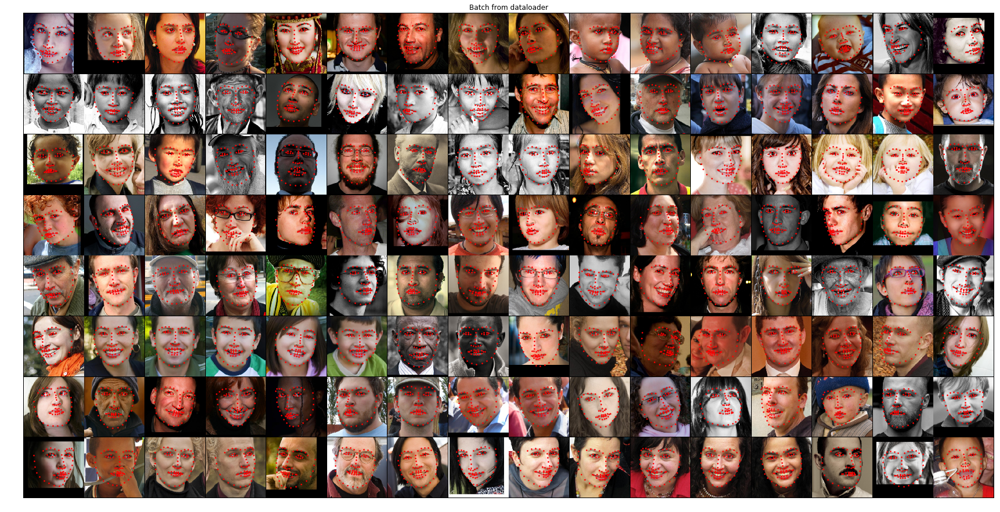

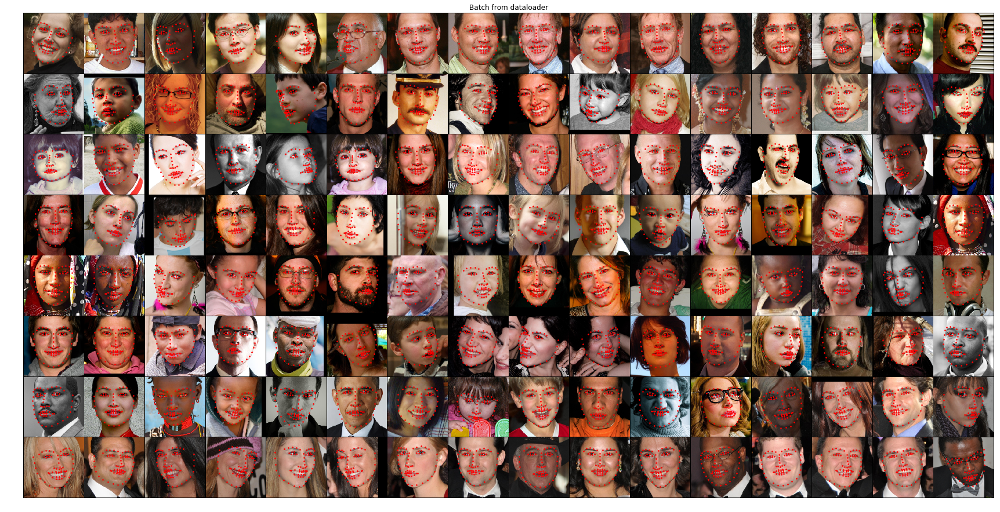

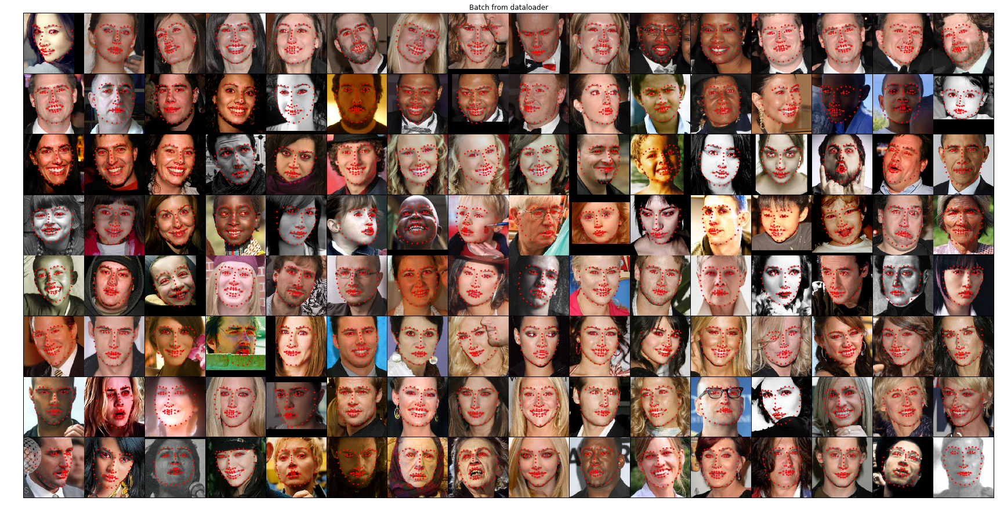

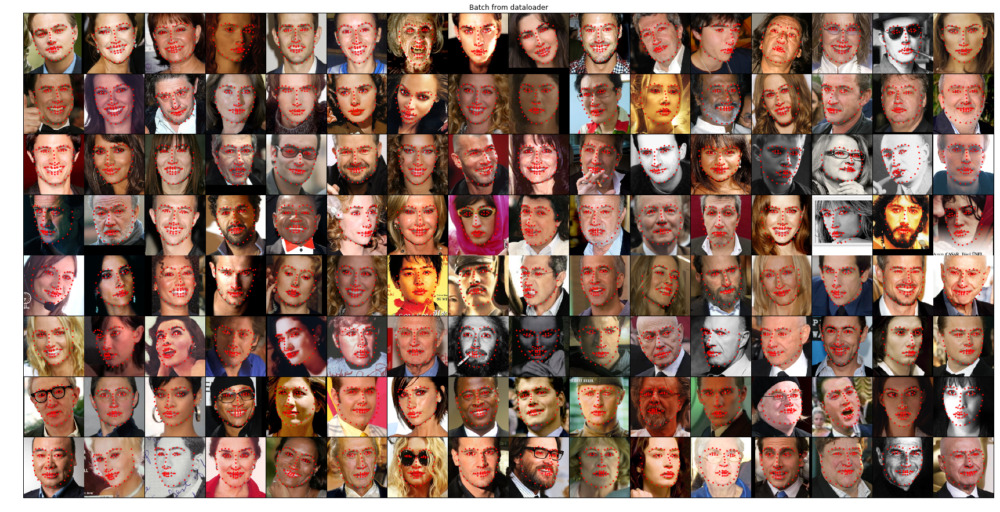

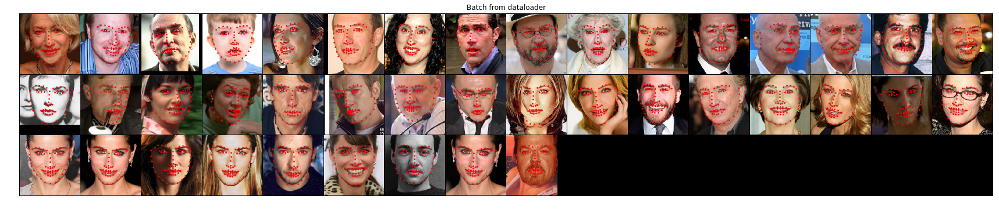

In [27]:
loss = 0
for i_batch, sample_batched in enumerate(common_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [28]:
loss/len(dataset)*68

4.04580846004471

### Challenging test

In [29]:
# load the dataset
challenging_set = FaceLandmarksDataset(csv_file='../data/challenging_test.csv',
                               root_dir='../data/',
                               transform=transforms)

challeging_loader = torch.utils.data.DataLoader(challenging_set, 
                batch_size=batch_size, num_workers=4)

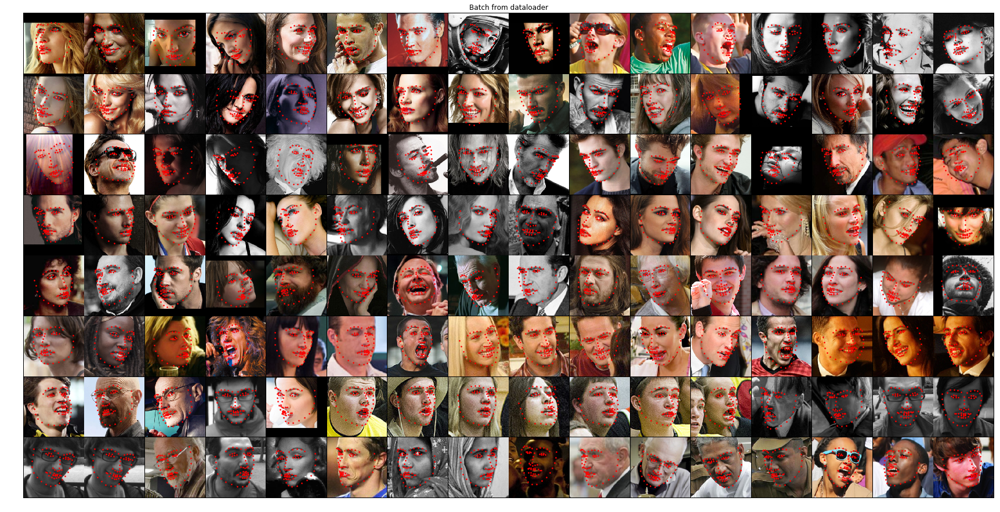

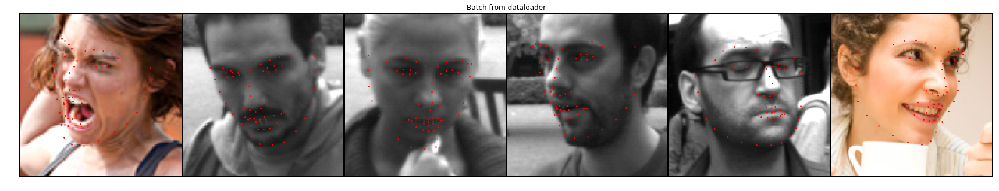

In [30]:
loss = 0
for i_batch, sample_batched in enumerate(challeging_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [31]:
loss/len(challenging_set)*68

9.275374704443696